In [56]:
import os
import glob
import pandas as pd

# ————————————— Configuration —————————————
SRC_ROOT    = "F:/Datasets/MY_DATASET/csi_csv"           # where your raw CSVs live
DST_ROOT    = "F:/Datasets/MY_DATASET/my_csi_csv_no_meta"    # where to save the pruned CSVs
ACTIVITIES  = ["bend", "run", "walk", "sitdown", "fall", "liedown", "standup"]
# columns to drop (zero-based, before any removal):
#DROP_COLS   = [0, 10, 24, 28, 29, 30, 31, 32, 33, 34, 35, 53, 56, 63]
# ————————————————————————————————————————————————

# make output dirs
os.makedirs(DST_ROOT, exist_ok=True)
for act in ACTIVITIES:
    os.makedirs(os.path.join(DST_ROOT, act), exist_ok=True)

# process
for act in ACTIVITIES:
    pattern = os.path.join(SRC_ROOT, act, "*.csv")
    for src_path in glob.glob(pattern):
        df = pd.read_csv(src_path, header=None)

        # 1) remove first & last row
        df = df.iloc[1:].reset_index(drop=True)

        # 2) drop those 14 columns
        #df = df.drop(columns=DROP_COLS, errors="ignore")

        # 3) save pruned CSV
        dst_path = os.path.join(DST_ROOT, act, os.path.basename(src_path))
        df.to_csv(dst_path, index=False, header=False)

print("✅ Pruned CSVs written to:", os.path.abspath(DST_ROOT))


✅ Pruned CSVs written to: F:\Datasets\MY_DATASET\my_csi_csv_no_meta


In [58]:
import os
import glob
import numpy as np
import pandas as pd

# === Configuration ===
SRC_ROOT   = "F:/Datasets/MY_DATASET/my_csi_csv_no_meta"            # folder with pruned CSVs containing -inf/NaNs
DST_ROOT   = "F:/Datasets/MY_DATASET/my_csi_trimmed_csv"           # destination for trimmed CSVs
ACTIVITIES = ["bend", "run", "walk", "sitdown", "fall", "liedown", "standup"]

# Create output dirs
os.makedirs(DST_ROOT, exist_ok=True)
for act in ACTIVITIES:
    os.makedirs(os.path.join(DST_ROOT, act), exist_ok=True)

# Process each file: drop trailing rows with all values non-finite
for act in ACTIVITIES:
    for src_path in glob.glob(os.path.join(SRC_ROOT, act, "*.csv")):
        df = pd.read_csv(src_path, header=None, dtype=str)
        
        # 1) Convert to numeric, coercing errors → NaN
        df_num = df.apply(pd.to_numeric, errors="coerce")
        
        # 2) Replace infinities with NaN
        df_num.replace([np.inf, -np.inf], np.nan, inplace=True)
        
        # 3) Drop any rows where all entries are NaN
        rows_before = df_num.shape[0]
        df_trimmed = df_num.dropna(how="all").reset_index(drop=True)
        rows_after = df_trimmed.shape[0]
        
        # 4) Save trimmed CSV
        dst_path = os.path.join(DST_ROOT, act, os.path.basename(src_path))
        df_trimmed.to_csv(dst_path, index=False, header=False)
        
        print(f"{act}/{os.path.basename(src_path)}: dropped {rows_before - rows_after} all-NaN rows")

print("\n✅ Trimmed CSVs saved under:", os.path.abspath(DST_ROOT))


bend/bend_000.csv: dropped 0 all-NaN rows
bend/bend_001.csv: dropped 0 all-NaN rows
bend/bend_002.csv: dropped 0 all-NaN rows
bend/bend_003.csv: dropped 1 all-NaN rows
bend/bend_004.csv: dropped 0 all-NaN rows
bend/bend_005.csv: dropped 0 all-NaN rows
bend/bend_006.csv: dropped 0 all-NaN rows
bend/bend_007.csv: dropped 0 all-NaN rows
bend/bend_008.csv: dropped 0 all-NaN rows
bend/bend_009.csv: dropped 0 all-NaN rows
bend/bend_010.csv: dropped 0 all-NaN rows
bend/bend_011.csv: dropped 0 all-NaN rows
bend/bend_012.csv: dropped 2 all-NaN rows
bend/bend_013.csv: dropped 1 all-NaN rows
bend/bend_014.csv: dropped 0 all-NaN rows
bend/bend_015.csv: dropped 0 all-NaN rows
bend/bend_016.csv: dropped 0 all-NaN rows
bend/bend_017.csv: dropped 0 all-NaN rows
bend/bend_018.csv: dropped 0 all-NaN rows
bend/bend_019.csv: dropped 0 all-NaN rows
bend/bend_020.csv: dropped 0 all-NaN rows
bend/bend_021.csv: dropped 0 all-NaN rows
bend/bend_022.csv: dropped 0 all-NaN rows
bend/bend_023.csv: dropped 0 all-N

In [59]:
import os
import glob
import pandas as pd

# Configuration
SRC_ROOT = "F:/Datasets/MY_DATASET/my_csi_trimmed_csv"
DST_ROOT = "F:/Datasets/MY_DATASET/my_csi_reordered"
ACTIVITIES = ["bend", "run", "walk", "sitdown", "fall", "liedown", "standup"]

# Create destination directories
os.makedirs(DST_ROOT, exist_ok=True)
for act in ACTIVITIES:
    os.makedirs(os.path.join(DST_ROOT, act), exist_ok=True)

# Define new column order: columns 32-63 first, then 0-31
new_order = list(range(32, 64)) + list(range(0, 32))

# Process each CSV
for act in ACTIVITIES:
    for src_path in glob.glob(os.path.join(SRC_ROOT, act, "*.csv")):
        df = pd.read_csv(src_path, header=None)
        # Reorder columns
        df_reordered = df.iloc[:, new_order]
        
        # Save reordered CSV
        dst_path = os.path.join(DST_ROOT, act, os.path.basename(src_path))
        df_reordered.to_csv(dst_path, index=False, header=False)

print("✅ Reordered CSVs saved under:", os.path.abspath(DST_ROOT))


✅ Reordered CSVs saved under: F:\Datasets\MY_DATASET\my_csi_reordered


In [76]:
import os
import glob
import pandas as pd

# Configuration
SRC_ROOT = "F:/Datasets/MY_DATASET/my_csi_reordered"      # folder with reordered CSVs
DST_ROOT = "F:/Datasets/MY_DATASET/my_csi_pruned_csv"    # destination for pruned CSVs
ACTIVITIES = ["bend", "run", "walk", "sitdown", "fall", "liedown", "standup"]

# Create destination directories
os.makedirs(DST_ROOT, exist_ok=True)
for act in ACTIVITIES:
    os.makedirs(os.path.join(DST_ROOT, act), exist_ok=True)

# Define null and DC subcarrier indices for 20 MHz (64 FFT bins)
# Null (guard) subcarriers: 0-5 and 59-63; DC subcarrier: 32
drop_indices = list(range(0, 5))   +[32] + [33] + list(range(59, 64))

# Process each CSV: drop null and DC subcarriers
for act in ACTIVITIES:
    for src_path in glob.glob(os.path.join(SRC_ROOT, act, "*.csv")):
        df = pd.read_csv(src_path, header=None)
        df_pruned = df.drop(columns=drop_indices)
        
        dst_path = os.path.join(DST_ROOT, act, os.path.basename(src_path))
        df_pruned.to_csv(dst_path, index=False, header=False)

print("✅ Pruned CSVs (null & DC removed) saved under:", os.path.abspath(DST_ROOT))


✅ Pruned CSVs (null & DC removed) saved under: F:\Datasets\MY_DATASET\my_csi_pruned_csv


In [33]:
import os
import glob
import pandas as pd

# ————————————— Configuration —————————————
SRC_ROOT   = "F:/Datasets/MY_DATASET_NOT_COMPLETE/my_csi_csv"            # raw CSVs
DST_ROOT   = "F:/Datasets/MY_DATASET_NOT_COMPLETE/my_csi_pruned_csv"     # where the cleaned CSVs will go
ACTIVITIES = ["bend", "run", "walk", "sitdown", "fall"]

# Original drop positions (0-based in the 64-col raw CSV):
#  • Guard (null) subcarriers:    0–5 and 59–63
#  • Pilot subcarriers:            11, 25, 39, 53
#  • DC subcarrier:                32
DROP_ORIG = list(range(0, 6)) + list(range(59, 64)) + [11, 25, 32, 39, 53]

# Half‐point for reordering
HALF = 32
# Compute where those original indices end up after
# swapping cols [32–63] in front of [0–31]:
DROP_AFTER_REORDER = []
for idx in DROP_ORIG:
    if idx >= HALF:
        # came from the second half → ends up at position idx-HALF
        DROP_AFTER_REORDER.append(idx - HALF)
    else:
        # came from the first half → ends up after the 32 new columns
        DROP_AFTER_REORDER.append(HALF + idx)
DROP_AFTER_REORDER = sorted(set(DROP_AFTER_REORDER))
# ————————————————————————————————————————————————

# Make sure output dirs exist
os.makedirs(DST_ROOT, exist_ok=True)
for act in ACTIVITIES:
    os.makedirs(os.path.join(DST_ROOT, act), exist_ok=True)

# Process & prune
for act in ACTIVITIES:
    for src_path in glob.glob(os.path.join(SRC_ROOT, act, "*.csv")):
        df = pd.read_csv(src_path, header=None)

        # 1) Drop the first (meta) row and the last row
        df = df.iloc[1:-1].reset_index(drop=True)

        # 2) Swap the two 32-col halves
        ncols = df.shape[1]
        order = list(range(HALF, ncols)) + list(range(0, HALF))
        df = df.iloc[:, order].reset_index(drop=True)

        # 3) Drop null, pilot, and DC subcarriers
        df = df.drop(columns=DROP_AFTER_REORDER, errors="ignore")

        # 4) Save
        dst = os.path.join(DST_ROOT, act, os.path.basename(src_path))
        df.to_csv(dst, index=False, header=False)

print("✅ Pruned CSVs written to:", os.path.abspath(DST_ROOT))


✅ Pruned CSVs written to: F:\Datasets\MY_DATASET_NOT_COMPLETE\my_csi_pruned_csv


C:\Users\Adrian\AppData\Local\Temp\ipykernel_17900\3006124401.py:24: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
C:\Users\Adrian\AppData\Local\Temp\ipykernel_17900\3006124401.py:24: UserWarning: Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.
  plt.tight_layout()


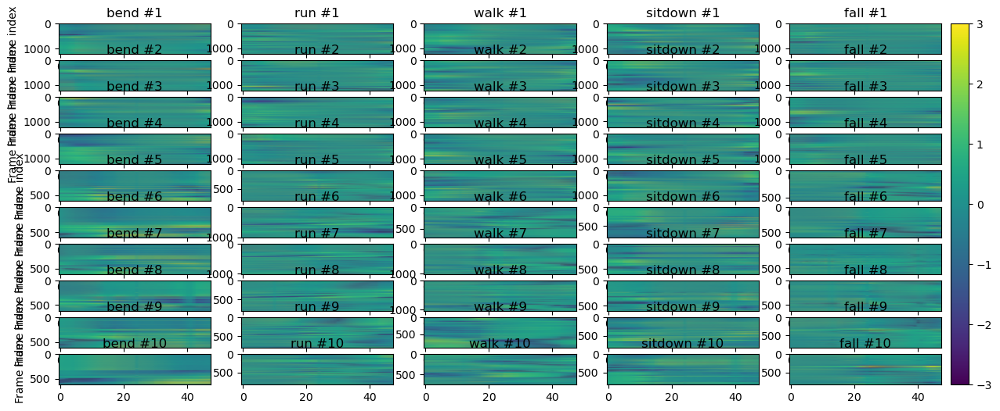

In [52]:
import os, numpy as np, pandas as pd, matplotlib.pyplot as plt

ACTIVITIES = ["bend","run","walk","sitdown","fall"]
ROOT = "F:\Datasets\MY_DATASET_NOT_COMPLETE\my_csi_trimmed_csv"

# Precompute global vmin/vmax, or just choose ±3:
norm = plt.Normalize(vmin=-3, vmax=+3)

fig, axes = plt.subplots(10, len(ACTIVITIES), figsize=(3*len(ACTIVITIES),6))
for j, activity in enumerate(ACTIVITIES):
    files = sorted(f for f in os.listdir(f"{ROOT}/{activity}") if f.endswith(".csv"))[:10]
    for i, fname in enumerate(files):
        data = pd.read_csv(f"{ROOT}/{activity}/{fname}",header=None).values
        # z-score per column
        m = data.mean(0); s = data.std(0); s[s==0]=1
        data_z = (data-m)/s

        ax = axes[i,j]
        im = ax.imshow(data_z, aspect="auto", norm=norm)
        ax.set_title(f"{activity} #{i+1}")
        if i==1: ax.set_xlabel("Subcarrier index")
        if j==0: ax.set_ylabel("Frame index")
fig.colorbar(im, ax=axes.ravel().tolist(), fraction=0.02, pad=0.01)
plt.tight_layout()
plt.show()


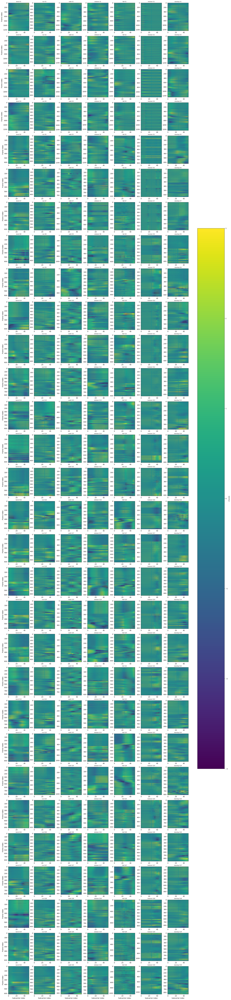

In [116]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

ACTIVITIES = ["bend","run","walk","sitdown","fall","liedown","standup"]
ROOT       = "F:\Datasets\MY_DATASET_NEW\csi_processed"
NUM_SAMPLES = 30

# create figure with constrained_layout
fig, axes = plt.subplots(
    nrows=NUM_SAMPLES, 
    ncols=len(ACTIVITIES), 
    figsize=(3*len(ACTIVITIES), 3*NUM_SAMPLES),
    constrained_layout=True
)

for j, activity in enumerate(ACTIVITIES):
    files = sorted(f for f in os.listdir(f"{ROOT}/{activity}") if f.endswith(".csv"))[:NUM_SAMPLES]
    for i, fname in enumerate(files):
        ax = axes[i, j]
        data = pd.read_csv(f"{ROOT}/{activity}/{fname}", header=None).values

        # fill NaNs and z-score
        #data = np.nan_to_num(data, nan=0.0)
        m = np.mean(data, axis=0)
        s = np.std(data, axis=0); s[s==0] = 1
        data_z = (data - m) / s

        im = ax.imshow(data_z, aspect="auto", vmin=-3, vmax=3)
        ax.set_title(f"{activity} S{i+1}", fontsize=8)
        if i == NUM_SAMPLES-1:
            ax.set_xlabel("Subcarrier index")
        if j == 0:
            ax.set_ylabel("Frame index")

# single shared colorbar on the right
cbar = fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.6)
cbar.set_label("Z-score")

plt.show()


In [41]:
import os
import glob
import pandas as pd
from collections import Counter

# === Configuration ===
SRC_ROOT   = "F:/Datasets/MY_DATASET_NOT_COMPLETE/my_csi_pruned_csv"  # folder containing pruned CSVs
ACTIVITIES = ["bend", "run", "walk", "sitdown", "fall"]

# Dictionary to hold counts of unique non-numeric values
non_numeric_counter = Counter()
files_scanned = 0

# Scan each CSV file
for act in ACTIVITIES:
    for csv_path in glob.glob(os.path.join(SRC_ROOT, act, "*.csv")):
        # Read entire CSV as strings
        df = pd.read_csv(csv_path, header=None, dtype=str)
        files_scanned += 1
        
        # Flatten all values into a single list
        values = df.values.flatten()
        
        # Identify non-numeric entries
        for v in values:
            # Check if value represents a number
            try:
                float(v)
            except (ValueError, TypeError):
                non_numeric_counter[v] += 1

# Display results
print(f"Scanned {files_scanned} CSV files in {SRC_ROOT}/")
print("Top non-numeric values and their counts:")
for val, count in non_numeric_counter.most_common(20):
    print(f"  '{val}': {count} occurrences")


Scanned 155 CSV files in F:/Datasets/MY_DATASET_NOT_COMPLETE/my_csi_pruned_csv/
Top non-numeric values and their counts:


C:\Users\Adrian\AppData\Local\Temp\ipykernel_17900\2707953701.py:36: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df = df.fillna(method="ffill").fillna(method="bfill")
C:\Users\Adrian\AppData\Local\Temp\ipykernel_17900\2707953701.py:36: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df = df.fillna(method="ffill").fillna(method="bfill")
C:\Users\Adrian\AppData\Local\Temp\ipykernel_17900\2707953701.py:36: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df = df.fillna(method="ffill").fillna(method="bfill")
C:\Users\Adrian\AppData\Local\Temp\ipykernel_17900\2707953701.py:36: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df = df.fi

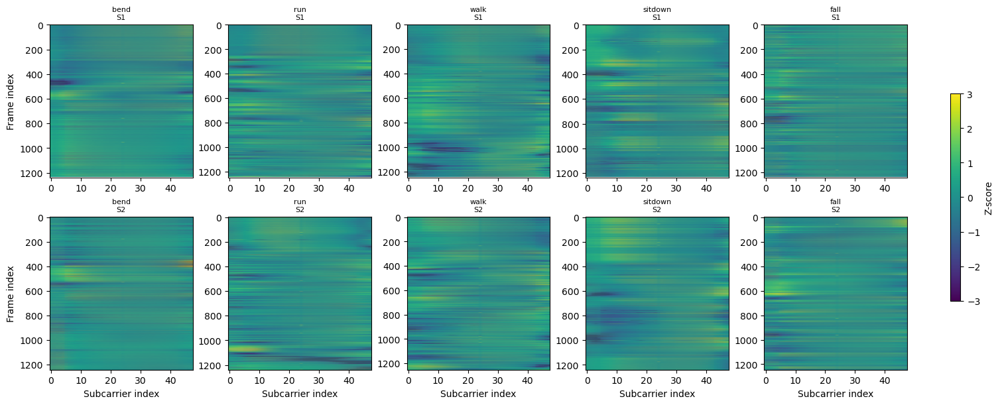

In [55]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# — Configuration —
PRUNED_ROOT  = "F:\Datasets\MY_DATASET_NOT_COMPLETE\my_csi_trimmed_csv"
ACTIVITIES   = ["bend", "run", "walk", "sitdown", "fall"]
NUM_SAMPLES  = 2   # how many per activity to plot
Z_CLIP       = 3.0 # ±3σ color scale

# Prepare figure
fig, axes = plt.subplots(
    nrows=NUM_SAMPLES,
    ncols=len(ACTIVITIES),
    figsize=(3 * len(ACTIVITIES), 3 * NUM_SAMPLES),
    constrained_layout=True
)

for j, activity in enumerate(ACTIVITIES):
    files = sorted(glob.glob(f"{PRUNED_ROOT}/{activity}/*.csv"))[:NUM_SAMPLES]
    for i in range(NUM_SAMPLES):
        ax = axes[i, j]
        if i >= len(files):
            ax.axis("off")
            continue

        # 1) Load as strings and coerce blanks → NaN, enforce numeric dtype
        df = pd.read_csv(files[i], header=None, dtype=str)
        df = df.replace(r'^\s*$', np.nan, regex=True)
        df = df.apply(pd.to_numeric, errors="coerce")

        # 2) Fill any NaNs by interpolation + ffill/bfill
        df = df.interpolate(axis=0, limit_direction="both")
        df = df.fillna(method="ffill").fillna(method="bfill")

        # 3) Z-score per column
        data = df.values
        m = np.mean(data, axis=0)
        s = np.std(data, axis=0)
        s[s == 0] = 1.0
        data_z = (data - m) / s

        # 4) Plot
        im = ax.imshow(data_z, aspect="auto", vmin=-Z_CLIP, vmax=Z_CLIP)
        ax.set_title(f"{activity}\nS{i+1}", fontsize=8)
        if i == NUM_SAMPLES - 1:
            ax.set_xlabel("Subcarrier index")
        if j == 0:
            ax.set_ylabel("Frame index")

# Shared colorbar
cbar = fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.6)
cbar.set_label("Z-score")

plt.show()


C:\Users\Adrian\anaconda3\envs\dl\lib\site-packages\numpy\lib\_nanfunctions_impl.py:1887: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr, where=where)


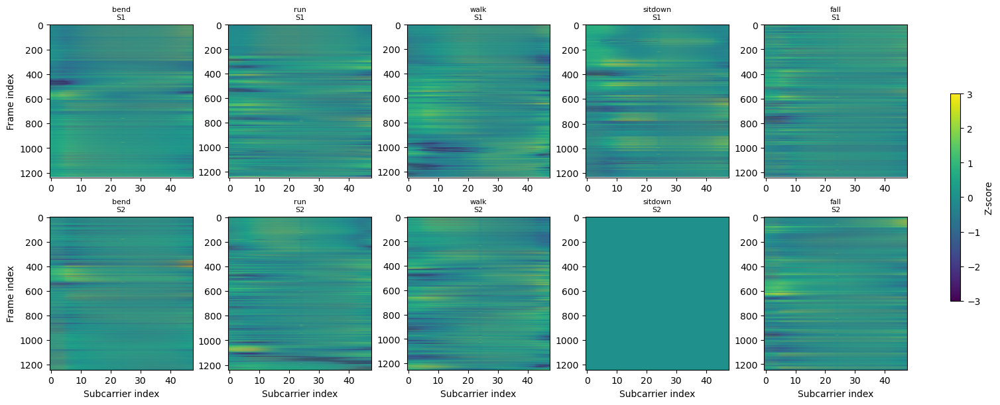

In [44]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# — Configuration —
PRUNED_ROOT  = "F:/Datasets/MY_DATASET_NOT_COMPLETE/my_csi_pruned_csv"
ACTIVITIES   = ["bend", "run", "walk", "sitdown", "fall"]
NUM_SAMPLES  = 2    # how many per activity to plot
Z_CLIP       = 3.0  # ±3σ color scale

# Prepare figure with constrained layout
fig, axes = plt.subplots(
    nrows=NUM_SAMPLES,
    ncols=len(ACTIVITIES),
    figsize=(3 * len(ACTIVITIES), 3 * NUM_SAMPLES),
    constrained_layout=True
)

for col_idx, activity in enumerate(ACTIVITIES):
    files = sorted(glob.glob(f"{PRUNED_ROOT}/{activity}/*.csv"))[:NUM_SAMPLES]
    for row_idx in range(NUM_SAMPLES):
        ax = axes[row_idx, col_idx]
        if row_idx >= len(files):
            ax.axis("off")
            continue

        # 1) Load as strings, coerce blanks → NaN, force numeric dtype
        df = pd.read_csv(files[row_idx], header=None, dtype=str)
        df = df.replace(r'^\s*$', np.nan, regex=True)
        df = df.apply(pd.to_numeric, errors="coerce")

        # 2) Interpolate & forward/backward fill
        df = df.interpolate(axis=0, limit_direction="both")
        df = df.ffill().bfill()

        # 3) Pull into numpy and zero-fill any residual NaN
        data = np.nan_to_num(df.values, nan=0.0)

        # 4) Z-score per column with nan-safe functions
        m = np.nanmean(data, axis=0)
        s = np.nanstd(data, axis=0)
        s[s == 0] = 1.0
        data_z = (data - m) / s

        # 5) Plot with a shared ±3σ scale
        im = ax.imshow(data_z, aspect="auto", vmin=-Z_CLIP, vmax=Z_CLIP)
        ax.set_title(f"{activity}\nS{row_idx+1}", fontsize=8)
        if row_idx == NUM_SAMPLES - 1:
            ax.set_xlabel("Subcarrier index")
        if col_idx == 0:
            ax.set_ylabel("Frame index")

# Single shared colorbar
cbar = fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.6)
cbar.set_label("Z-score")

plt.show()


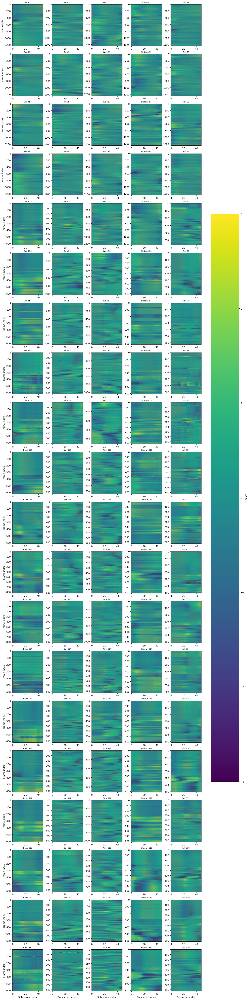

In [50]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# — Configuration —
PRUNED_ROOT  = "F:\Datasets\MY_DATASET_NOT_COMPLETE\my_csi_trimmed_csv"
ACTIVITIES   = ["bend", "run", "walk", "sitdown", "fall"]
NUM_SAMPLES  = 20    # how many per activity to plot
Z_CLIP       = 3.0  # ±3σ color scale

# Prepare figure with constrained layout
fig, axes = plt.subplots(
    nrows=NUM_SAMPLES,
    ncols=len(ACTIVITIES),
    figsize=(3 * len(ACTIVITIES), 3 * NUM_SAMPLES),
    constrained_layout=True
)

for col_idx, activity in enumerate(ACTIVITIES):
    # pick first NUM_SAMPLES CSVs
    files = sorted(glob.glob(os.path.join(PRUNED_ROOT, activity, "*.csv")))[:NUM_SAMPLES]
    for row_idx in range(NUM_SAMPLES):
        ax = axes[row_idx, col_idx]
        if row_idx >= len(files):
            ax.axis("off")
            continue

        # 1) Load as strings and coerce blanks → NaN
        df = pd.read_csv(files[row_idx], header=None, dtype=str)
        df = df.replace(r'^\s*$', np.nan, regex=True)
        df = df.apply(pd.to_numeric, errors="coerce")

        # 2) Interpolate & fill any remaining NaNs
        df = df.interpolate(axis=0, limit_direction="both")
        df = df.ffill().bfill()

        # 3) Convert to float64
        data = df.values.astype(np.float64)

        # 4) Stable z-scoring per column
        m = np.nanmean(data, axis=0)
        diff = data - m
        with np.errstate(over="ignore", invalid="ignore"):
            var = np.nanmean(diff * diff, axis=0)
        s = np.sqrt(var)
        s[s == 0] = 1.0
        data_z = diff / s

        # 5) Plot with shared ±3σ scale
        im = ax.imshow(data_z, aspect="auto", vmin=-Z_CLIP, vmax=Z_CLIP)
        ax.set_title(f"{activity.capitalize()} S{row_idx+1}", fontsize=8)
        if row_idx == NUM_SAMPLES - 1:
            ax.set_xlabel("Subcarrier index")
        if col_idx == 0:
            ax.set_ylabel("Frame index")

# Shared colorbar on the right
cbar = fig.colorbar(im, ax=axes.ravel().tolist(), shrink=0.6)
cbar.set_label("Z-score")

plt.show()


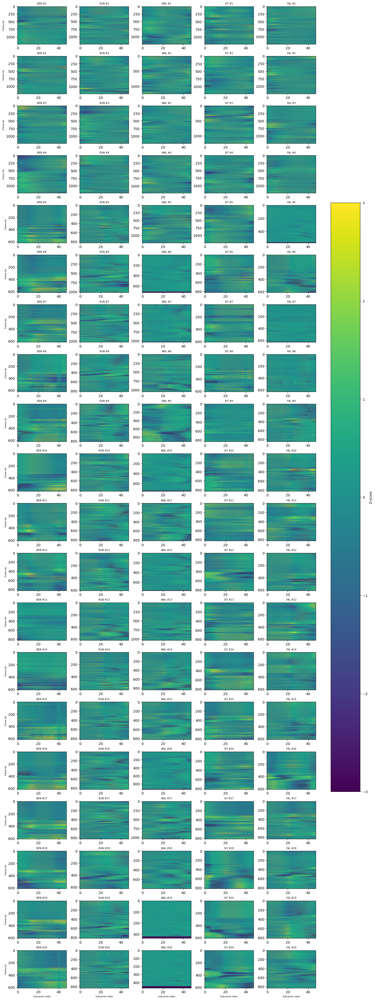

In [47]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# — Configuration —
PRUNED_ROOT  = "F:/Datasets/MY_DATASET_NOT_COMPLETE/my_csi_pruned_csv"
ACTIVITIES   = ["bend", "run", "walk", "sitdown", "fall"]
NUM_SAMPLES  = 20   # number of samples per activity
Z_CLIP       = 3.0  # ±3σ color scale

# Prepare figure grid
fig, axes = plt.subplots(
    nrows=NUM_SAMPLES,
    ncols=len(ACTIVITIES),
    figsize=(3 * len(ACTIVITIES), 2 * NUM_SAMPLES),
    constrained_layout=True
)

first_im = None  # to store the first image for colorbar

for col_idx, activity in enumerate(ACTIVITIES):
    files = sorted(glob.glob(os.path.join(PRUNED_ROOT, activity, "*.csv")))[:NUM_SAMPLES]
    for row_idx in range(NUM_SAMPLES):
        ax = axes[row_idx, col_idx]
        if row_idx >= len(files):
            ax.axis("off")
            continue

        # 1) Load as strings, blanks → NaN, then numeric
        df = pd.read_csv(files[row_idx], header=None, dtype=str)
        df = df.replace(r'^\s*$', np.nan, regex=True)
        df = df.apply(pd.to_numeric, errors="coerce")

        # 2) Interpolate and fill NaNs
        df = df.interpolate(axis=0, limit_direction="both").ffill().bfill()

        # 3) Convert to float64 and replace any NaNs/Infs with zero
        data = df.values.astype(np.float64)
        data = np.nan_to_num(data, nan=0.0, posinf=0.0, neginf=0.0)

        # 4) Numerically-stable z-score per column
        m = np.mean(data, axis=0)
        diff = data - m
        with np.errstate(over="ignore", invalid="ignore"):
            var = np.mean(diff * diff, axis=0)
        s = np.sqrt(var)
        s[~np.isfinite(s)] = 1.0
        data_z = diff / s

        # 5) Plot with fixed ±3σ scale
        im = ax.imshow(data_z, aspect="auto", vmin=-Z_CLIP, vmax=Z_CLIP)
        if first_im is None:
            first_im = im
        ax.set_title(f"{activity[:3].upper()} #{row_idx+1}", fontsize=7)
        if row_idx == NUM_SAMPLES - 1:
            ax.set_xlabel("Subcarrier index", fontsize=6)
        if col_idx == 0:
            ax.set_ylabel("Frame idx", fontsize=6)

# Add a single shared colorbar
if first_im is not None:
    cbar = fig.colorbar(first_im, ax=axes.ravel().tolist(), shrink=0.6)
    cbar.set_label("Z-score")

plt.show()


In [48]:
import os
import glob
import pandas as pd

# === Configuration ===
SRC_ROOT   = "F:/Datasets/MY_DATASET_NOT_COMPLETE/my_csi_pruned_csv"  # adjust if needed
ACTIVITIES = ["bend", "run", "walk", "sitdown", "fall"]
NUM_ROWS   = 10  # number of tail rows to inspect per file

for act in ACTIVITIES:
    print(f"\n=== Activity: {act} ===")
    # grab first CSV in each activity for inspection
    files = sorted(glob.glob(os.path.join(SRC_ROOT, act, "*.csv")))
    if not files:
        print("  No files found.")
        continue
    
    sample_csv = files[1]
    print(f"Inspecting file: {os.path.basename(sample_csv)}")
    
    # Load without headers
    df = pd.read_csv(sample_csv, header=None)
    
    # Get the last NUM_ROWS rows
    tail_df = df.tail(NUM_ROWS)
    
    # Print types and contents
    print("\nRow index | Types per column")
    print(tail_df.dtypes.to_frame().T)
    print("\nLast rows content:")
    print(tail_df.to_string(index=True, header=False))
    
    # Only inspect the first file per activity
    # Remove this break to inspect all files
    # break



=== Activity: bend ===
Inspecting file: bend_001.csv

Row index | Types per column
        0        1        2        3        4        5        6        7   \
0  float64  float64  float64  float64  float64  float64  float64  float64   

        8        9   ...       38       39       40       41       42  \
0  float64  float64  ...  float64  float64  float64  float64  float64   

        43       44       45       46       47  
0  float64  float64  float64  float64  float64  

[1 rows x 48 columns]

Last rows content:
1234  48.941831  49.426479  49.950470  50.240668  50.547088  51.605886  52.097294  52.496972  53.065623  53.513653  53.951184  54.426459  54.885578  55.207625  55.368676  55.522788  55.612374  55.796944  56.026600  56.038597  55.908084  55.880621  55.935486  55.827688  56.086287  56.371414  56.517595  56.704091  56.953591  57.238504  57.419902  57.580007  57.658250  57.731638  57.736409  57.556081  57.316121  57.103290  56.857382  56.637028  56.310225  56.033577  55.78

In [49]:
import os
import glob
import numpy as np
import pandas as pd

# === Configuration ===
SRC_ROOT   = "F:/Datasets/MY_DATASET_NOT_COMPLETE/my_csi_pruned_csv"            # folder with pruned CSVs containing -inf/NaNs
DST_ROOT   = "F:/Datasets/MY_DATASET_NOT_COMPLETE/my_csi_trimmed_csv"           # destination for trimmed CSVs
ACTIVITIES = ["bend", "run", "walk", "sitdown", "fall"]

# Create output dirs
os.makedirs(DST_ROOT, exist_ok=True)
for act in ACTIVITIES:
    os.makedirs(os.path.join(DST_ROOT, act), exist_ok=True)

# Process each file: drop trailing rows with all values non-finite
for act in ACTIVITIES:
    for src_path in glob.glob(os.path.join(SRC_ROOT, act, "*.csv")):
        df = pd.read_csv(src_path, header=None, dtype=str)
        
        # 1) Convert to numeric, coercing errors → NaN
        df_num = df.apply(pd.to_numeric, errors="coerce")
        
        # 2) Replace infinities with NaN
        df_num.replace([np.inf, -np.inf], np.nan, inplace=True)
        
        # 3) Drop any rows where all entries are NaN
        rows_before = df_num.shape[0]
        df_trimmed = df_num.dropna(how="all").reset_index(drop=True)
        rows_after = df_trimmed.shape[0]
        
        # 4) Save trimmed CSV
        dst_path = os.path.join(DST_ROOT, act, os.path.basename(src_path))
        df_trimmed.to_csv(dst_path, index=False, header=False)
        
        print(f"{act}/{os.path.basename(src_path)}: dropped {rows_before - rows_after} all-NaN rows")

print("\n✅ Trimmed CSVs saved under:", os.path.abspath(DST_ROOT))


bend/bend_000.csv: dropped 0 all-NaN rows
bend/bend_001.csv: dropped 0 all-NaN rows
bend/bend_002.csv: dropped 0 all-NaN rows
bend/bend_003.csv: dropped 0 all-NaN rows
bend/bend_004.csv: dropped 0 all-NaN rows
bend/bend_005.csv: dropped 0 all-NaN rows
bend/bend_006.csv: dropped 0 all-NaN rows
bend/bend_007.csv: dropped 0 all-NaN rows
bend/bend_008.csv: dropped 0 all-NaN rows
bend/bend_009.csv: dropped 0 all-NaN rows
bend/bend_010.csv: dropped 0 all-NaN rows
bend/bend_011.csv: dropped 0 all-NaN rows
bend/bend_012.csv: dropped 1 all-NaN rows
bend/bend_013.csv: dropped 0 all-NaN rows
bend/bend_014.csv: dropped 0 all-NaN rows
bend/bend_015.csv: dropped 0 all-NaN rows
bend/bend_016.csv: dropped 0 all-NaN rows
bend/bend_017.csv: dropped 0 all-NaN rows
bend/bend_018.csv: dropped 0 all-NaN rows
bend/bend_019.csv: dropped 0 all-NaN rows
bend/bend_020.csv: dropped 0 all-NaN rows
bend/bend_021.csv: dropped 0 all-NaN rows
bend/bend_022.csv: dropped 0 all-NaN rows
bend/bend_023.csv: dropped 0 all-N